# GDAL Primer
A dataset in GDAL is a placeholder for the file itself. It does, however, only read the metadata and is rather lightweight. You can explore the projection and the content and very low cost.

In [4]:
from osgeo import gdal;
import numpy as np
from matplotlib import pyplot as plt
%matplotlib inline
plt.rcParams['figure.dpi'] = 600 #higher resolution of plots

## The Dataset Object
First, download a big TIFF image (this one is a Germany cover from Sentinel 2)

[https://api.bgd.ed.tum.de/datasets/germany/germany.tiff](https://api.bgd.ed.tum.de/datasets/germany/germany.tiff)


In [6]:
dataset = gdal.Open("germany.tiff", gdal.GA_ReadOnly)
if not dataset:
    print("Dataset not found.")
else:
    print("Driver: {}/{}".format(dataset.GetDriver().ShortName,
                            dataset.GetDriver().LongName))
    print("Size is {} x {} x {}".format(dataset.RasterXSize,
                                    dataset.RasterYSize,
                                    dataset.RasterCount))
    print("Projection is {}".format(dataset.GetProjection()))
    geotransform = dataset.GetGeoTransform()
    if geotransform:
        print("Origin = ({}, {})".format(geotransform[0], geotransform[3]))
        print("Pixel Size = ({}, {})".format(geotransform[1], geotransform[5]))


Driver: GTiff/GeoTIFF
Size is 67235 x 94080 x 3
Projection is LOCAL_CS["WGS 84 / Pseudo-Mercator",UNIT["metre",1,AUTHORITY["EPSG","9001"]],AXIS["Easting",EAST],AXIS["Northing",NORTH]]
Origin = (641594.9109931737, 7370990.488857678)
Pixel Size = (15.545613327413848, -15.545613327413848)


# Raster Bands
This file-level information fixes projection, georeference, and pixel meaning, and shape. But where is the data? It is accessible from Band objects, which again do not read data, but bandwise metadata only. Let us assume we have at least one band

In [7]:
if dataset.RasterCount < 1:
    print("This file has no bands. This is possible, but then we cant access a band")
else:
    for i in range(dataset.RasterCount):
        band = dataset.GetRasterBand(i+1) # unfortunately, raster bands start with index 1
        print("Band Type={}".format(gdal.GetDataTypeName(band.DataType)))

        min = band.GetMinimum()
        max = band.GetMaximum()
        if not min or not max:
            print ("Warning: I have to cmopute min and max as they are not given. This can take time")
            (min,max) = band.ComputeRasterMinMax(True)
        print("Min={:.3f}, Max={:.3f}".format(min,max))

        if band.GetOverviewCount() > 0:
            print("Band has {} overviews".format(band.GetOverviewCount()))

        if band.GetRasterColorTable():
            print("Band has a color table with {} entries".format(band.GetRasterColorTable().GetCount()))

Band Type=Byte
Min=0.000, Max=255.000
Band Type=Byte
Min=0.000, Max=255.000
Band Type=Byte
Min=0.000, Max=255.000


What we can see here is that this file is already quantized and arranged for screen display and/or deep learning with RGB image pretrained models as three bands for red, green, and blue are given and data has been scaled to the range 0..255. This is not common, but for germany.tiff helps us not to learn too much in one step

# Reading from the Raster
There are now three ways of reading from the raster depending on the context.
- One is to read the whole raster (ReadAsArray), but this won't work for germany as it is a bit large.
- Another one is to read certain pixels (TIFF files are organized such that you can read only parts of it)
- The third one is to rely on the Linux kernel to memory-map the whole file and access it as a numpy array.

We will now use the second one.But as a preparation, we will first localize Munich Airport. We know the GPS coordinates are 11.7854,48.3536. We compute the EPSG 3857 (webmercator) coordinates to be.

1311798,6165451

What do we have to do? Simplifying using that two entries are zero (see below), we come up with
$$
x_p = x_0 + x_r \cdot geotransform
$$

We need to use the geotransform to find the integer raster coordinates of this.

A geotransform consists in a set of 6 coefficients (see https://gdal.org/tutorials/geotransforms_tut.html):

- GT(0) x-coordinate of the upper-left corner of the upper-left pixel.
- GT(1) w-e pixel resolution / pixel width.
- GT(2) row rotation (typically zero).
- GT(3) y-coordinate of the upper-left corner of the upper-left pixel.
- GT(4) column rotation (typically zero).
- GT(5) n-s pixel resolution / pixel height (negative value for a north-up image).

Hence taking into account that GT(2) == 0 and GT(4) == 0, we have equations for $x_p$ (and $y_p$) being the point in the projection and $x_r$ being the point in the raster (integer coordinates)

$$
x_p = GT(0) + x_r \cdot GT(1)
$$

We have to solve for x_r to find the raster coordinates, which is easy:
$$
x_r = \frac{x_p - GT(0)}{GT(1)}
$$

Let us put this into a python function:



In [8]:
def world2raster (point, geotransform):
    x,y = point # increases readability
    # u,v will be raster x,y
    u = (x-geotransform[0]) / geotransform[1]
    v = (y-geotransform[3]) / geotransform[5]
    return int(u),int(v)
def raster2world (point, geotransform):
    u,v = point # increases readability
    # u,v will be raster x,y
    x = geotransform[0] + u *  geotransform[1]
    y = geotransform[3] + v *  geotransform[5]
    return x,y


# let us do a quick test
munichairport = (1311798,6165451)
munichairport_raster = world2raster(munichairport,geotransform)
print("Raster Coordinates:", munichairport_raster)
# let us do a more advanced test by going down to percentages which we can "test" in QGIS
print("From the topleft, it is in percentages around %.1f %.1f" % (munichairport_raster[0] / dataset.RasterXSize * 100,munichairport_raster[1] / dataset.RasterYSize * 100) )

Raster Coordinates: (43112, 77548)
From the topleft, it is in percentages around 64.1 82.4


This makes some sense as Munich is located more in the South of Germany (82%) and east of the middle, but not far east. Let us see later whether it is correct.

Let us now read an area of 10km by 10km. We first need to compute the number of pixels for about 1km from the geotransform.

In [12]:
xcount, ycount = int(25000 / geotransform[1]), int(25000/geotransform[5])
print (xcount)
print (ycount)
# This shows that Y might be flipped when reading data such that increasing the vertical coordiate in the raster
# decreases the vertical coordiante in the world

print("The box:")


1608
-1608
The box:


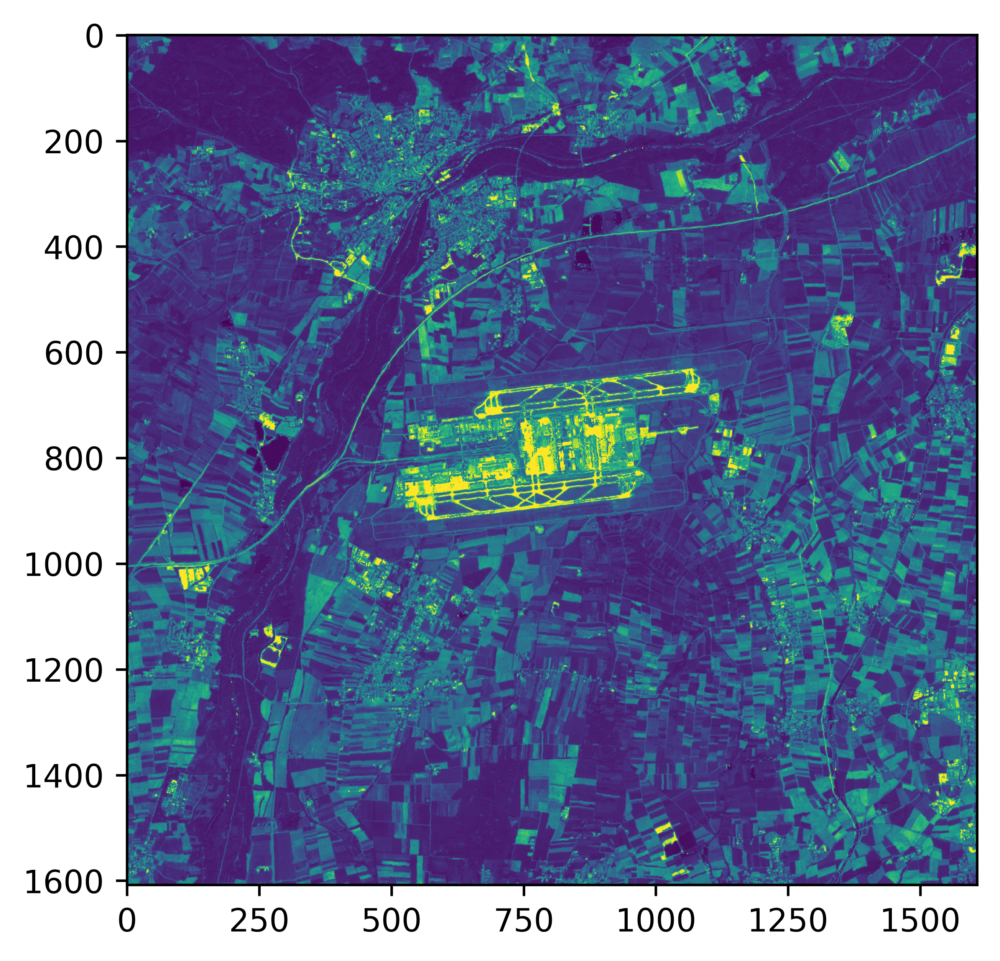

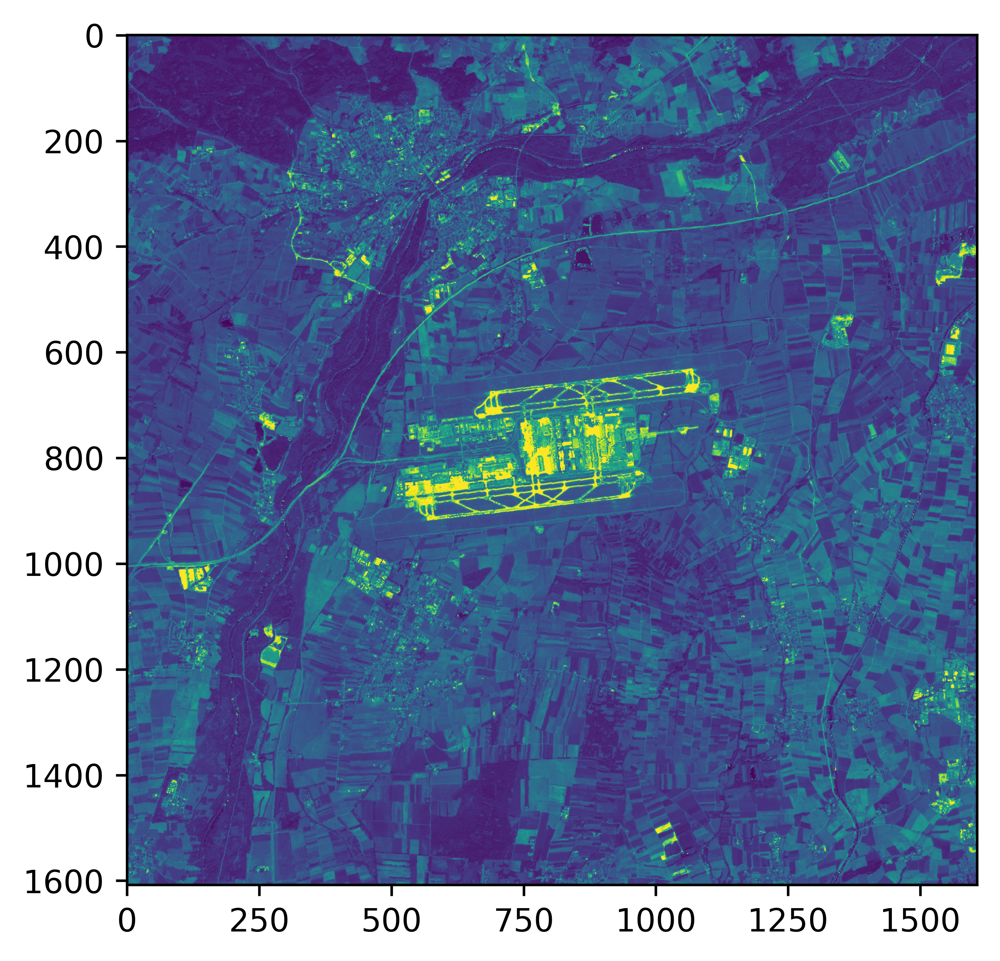

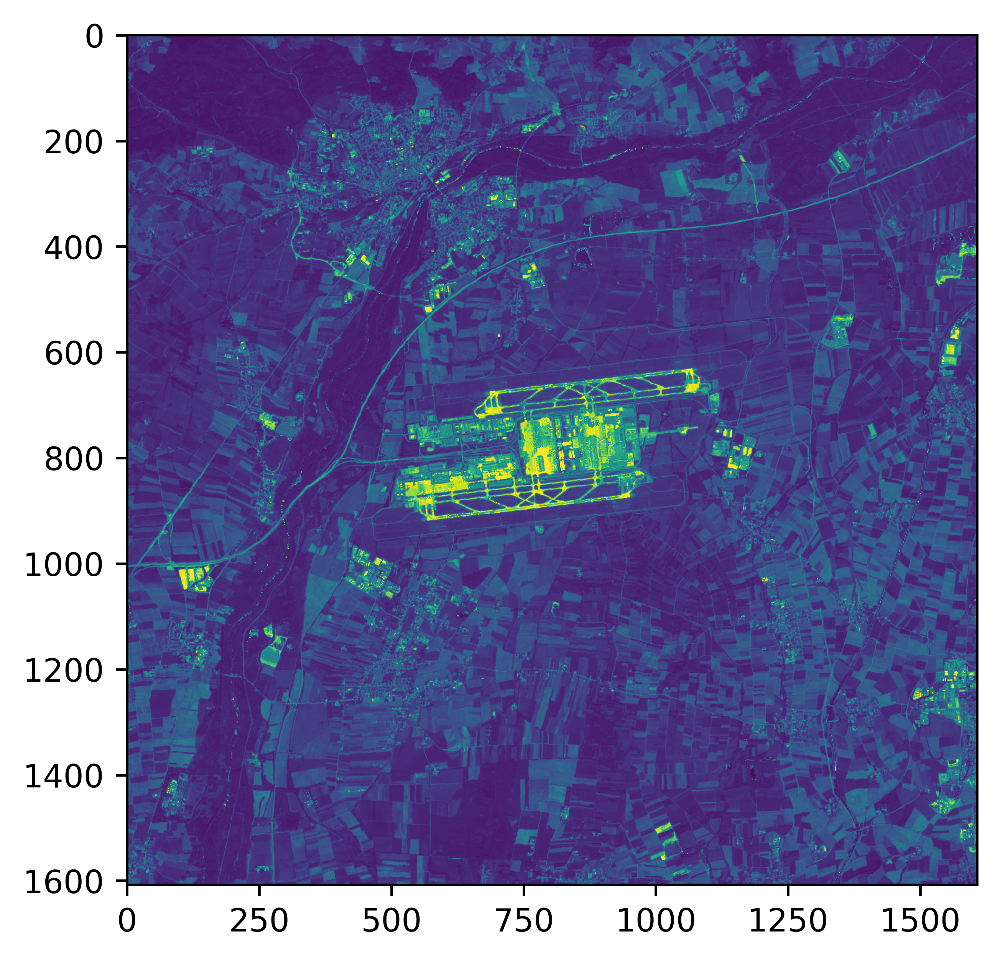

In [13]:
import struct
w,h = abs(xcount), abs(ycount)

red = dataset.GetRasterBand(1)
green = dataset.GetRasterBand(2)
blue = dataset.GetRasterBand(3)

def read_unpack(theband, x0,y0,w,h):
    imagedata = theband.ReadRaster(xoff=x0, 
                            yoff=y0,
                        xsize=w, ysize=h,
                        buf_xsize=w, buf_ysize=h,
                        buf_type=gdal.GDT_Float32)
    image = np.array(struct.unpack('f' * w*h, imagedata)).reshape(h,w).astype(np.ubyte)
    return image
    
redi = read_unpack(red, munichairport_raster[0]-(w // 2), munichairport_raster[1]-(h // 2),w,h)
greeni = read_unpack(green, munichairport_raster[0]-(w // 2), munichairport_raster[1]-(h // 2),w,h)
bluei = read_unpack(blue, munichairport_raster[0]-(w // 2), munichairport_raster[1]-(h // 2),w,h)
# imagedata is now some data that is not yet ready for python, we need to parse it
#


if True:
    
    plt.imshow(redi)
    plt.show()
    plt.imshow(greeni)
    plt.show()
    plt.imshow(bluei)
    plt.show()

# True Color Snippet

The following figure shows Munich Airport in the center

(1608, 1608, 3)


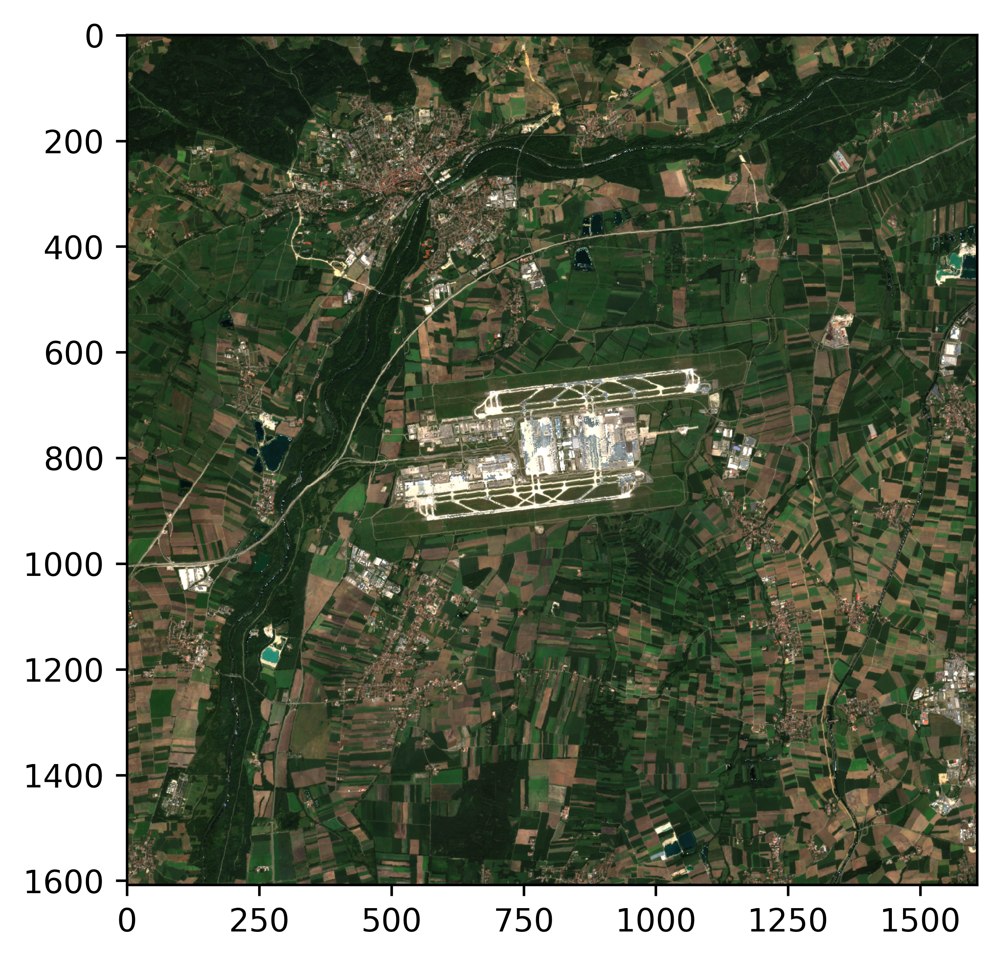

In [14]:
# Now we need to make an RGB out of it
rgb = np.stack([redi,greeni,bluei], axis=-1)
print(rgb.shape)
plt.imshow(rgb)


# Conclusion

This tutorial has shown how to use a 10 GB file to selectively find some satellite image information given a location on Earth. It goes through the coordinate transformations necessary, the conversions between raster and world, the acquisition of data as indivudal bands including the python parsing using the struct package, and the visualization using MATPLOTLIB.

Maybe, we should store the image as a final step. There are two ways: we can save the plot (the last active figure) or  we just store the image information using the imageio package. Lets do both

In [15]:
plt.savefig("plot.png")
import imageio
imageio.imwrite("image.png", rgb)

<Figure size 3840x2880 with 0 Axes>